# Hierarchical Clustering Using Context Sensitive Embeddings for Cord-19 

In [1]:
import pandas as pd

In [2]:
df = pd.read_csv("clean_noncomm_use.csv")

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2490 entries, 0 to 2489
Data columns (total 9 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   paper_id          2490 non-null   object
 1   title             2199 non-null   object
 2   authors           2214 non-null   object
 3   affiliations      2214 non-null   object
 4   abstract          1798 non-null   object
 5   text              2490 non-null   object
 6   bibliography      2490 non-null   object
 7   raw_authors       2490 non-null   object
 8   raw_bibliography  2490 non-null   object
dtypes: object(9)
memory usage: 175.2+ KB


## Project Pipeline

The following figure describes our project pipeline and general flow of operations.

![alt text](Project_Pipeline.png "Title")

In [4]:
df = df.dropna()

## Detecting the english literature

reference: https://www.kaggle.com/maksimeren/covid-19-literature-clustering

In [5]:
import plotly.io as pio
pio.renderers.default='notebook'

In [6]:
# ! pip install langdetect
from langdetect import detect

In [7]:
from langdetect import DetectorFactory
DetectorFactory.seed = 0

In [8]:
lang = df.abstract.apply(detect)

In [9]:
lang_vis = lang.to_frame().groupby("abstract").apply(len)

In [10]:
import plotly.express as px
import plotly.graph_objects as go

In [11]:
px.bar(x=lang_vis.index,y = lang_vis, color =lang_vis.index,labels = {'x':"Language", 'y':"Count"},
       text = lang_vis).update_layout(title= "Languages in Articles")

**Filtering only the english literature**

In [12]:
df = df[lang=="en"]

In [13]:
df = df.reset_index(drop=True)

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1684 entries, 0 to 1683
Data columns (total 9 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   paper_id          1684 non-null   object
 1   title             1684 non-null   object
 2   authors           1684 non-null   object
 3   affiliations      1684 non-null   object
 4   abstract          1684 non-null   object
 5   text              1684 non-null   object
 6   bibliography      1684 non-null   object
 7   raw_authors       1684 non-null   object
 8   raw_bibliography  1684 non-null   object
dtypes: object(9)
memory usage: 118.5+ KB


Histogram to find the maximum length of sequences

In [15]:
px.histogram(df.abstract.apply(lambda x: len(x.replace("Abstract","").strip().split())),
             marginal='box',labels = {'value':"Number of words in abstract"}
            ).update_layout(title = "The Distribution Word Counts in Abstracts")

####  Preprocessing the abstracts of paper

In [16]:
# !pip install scispacy
# !pip install spacy 

In [17]:
import string
import re
from nltk.tokenize import word_tokenize
from nltk.stem.wordnet import WordNetLemmatizer
import spacy
# import scispacy
from nltk.corpus import stopwords
from spacy.lang.en.stop_words import STOP_WORDS

# using stopwords from both nltk and spacy
custom_stopwords = list(set(stopwords.words('english') + list(STOP_WORDS))) + ["abstract"]


#This is a faster implementation of tokenization which uses nltk library instead of spacy 
def preprocess_sentences(sentence: str) -> [str]:    
    """This function is used preprocessing for word2vec. It lowercases, removes punctuation , digits, tokenizes
    and lemmatizes the input"""
    sentence = str(sentence)
    lem = WordNetLemmatizer()
    sentence = sentence.lower()
    sentence = sentence.translate(str.maketrans('', '', string.punctuation+string.digits))
    sentence_tokens = word_tokenize(sentence)
    sentence_tokens = [lem.lemmatize(word) for word in sentence_tokens if word not in custom_stopwords]
    return sentence_tokens

In [18]:
# This is used to show the progress while applying operations
from tqdm import tqdm
tqdm.pandas(desc="Applying operation")

/anaconda3/envs/va_env1/lib/python3.8/site-packages/tqdm/std.py:670: FutureWarning:

The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version



In [19]:
df['abstract_token'] = df.abstract.progress_apply(preprocess_sentences)

Applying operation: 100%|██████████| 1684/1684 [00:06<00:00, 242.65it/s]


### Word2vec embeddings

In [20]:
from gensim.models import Word2Vec


The word2vec model can be trained again by uncommenting the following lines

In [21]:
# list_of_tokens = df.abstract_token.to_list()
# word2vec = Word2Vec(list_of_tokens, min_count=1, size =100,iter=200)

Included word2vec model trained by us on Cord-19 abstract

In [22]:
word2vec = Word2Vec.load("Word2vec.model")

In [23]:
word2vec.wv.most_similar('bat')

[('rodent', 0.5634630918502808),
 ('phitsanulok', 0.5609463453292847),
 ('sawan', 0.5536580085754395),
 ('astroviruses', 0.5428025126457214),
 ('insectivorous', 0.5309196710586548),
 ('leafnosed', 0.5115238428115845),
 ('epomophorus', 0.5058814287185669),
 ('nectivorous', 0.5011128187179565),
 ('delicacy', 0.5004317760467529),
 ('fruit', 0.4987610876560211)]

In [24]:
import numpy as np
def vectorize_word2vec(sentence_words_list:[str], model=word2vec) ->[float] :
    """This function will vectorise the words in the abstract and reduce the whole abstract by mean."""

    # unfound tokens are replaced by zeros
    if len(sentence_words_list) == 0:
        return np.zeros(100) + 1e-100
    sentence_words_list = model.wv[sentence_words_list]
    sentence_words_list = np.mean(sentence_words_list,axis=0)
    
    return sentence_words_list

In [25]:
word2vec_embedding = np.array([x for x in df.abstract_token.apply(vectorize_word2vec)])

## Bert Embeddings

Pre-processing for Bert Models:
* No lowercasing is done. Since casing is important for medical domain
* The Word 'abstract' is removed from Abstracts.
* punctuation and digits are removed


In [26]:
def preprocess_bert(sentence: str) -> [str]:  
    """It used to remove repeatative words like abstract and number before using as input for bert models"""
    sentence = sentence.replace("Abstract","").strip()
    sentence = sentence.translate(str.maketrans('', '', string.punctuation+string.digits+"±"))

    return sentence

df.loc[:,'abstract']  = df.abstract.apply(preprocess_bert )

###  Using Sentence Bert

In [27]:
# !pip install sentence-transformers

In [28]:
import pickle

In [29]:
from sentence_transformers import SentenceTransformer,models,util
from transformers import AutoTokenizer, AutoModel
import torch

In [30]:
# This pooling layer is used at the end of original architectures
pooling_model = models.Pooling(768,pooling_mode_mean_tokens=True,
                                   pooling_mode_cls_token=False,
                                   pooling_mode_max_tokens=False)

### S-biobert embedding

This model uses the biobert_v1.1 pumbed as it's base. No fine-tuning was performed on NLI dataset.
We use the sentence transformer library to add a mean pooling layer to obtain the sentence embedding. 

Base model: monologg/biobert_v1.1_pubmed from HuggingFace's AutoModel.

reference : https://huggingface.co/monologg/biobert_v1.1_pubmed

In [ ]:
# Old code used for chunking
# S_biobert = SentenceTransformer('monologg/biobert_v1.1_pubmed')
# S_biobert_embedding = []
# for x in tqdm(df.abstract):
#     em = S_biobert.encode(x)
#     S_biobert_embedding.append(em)

# S_biobert_embedding = np.array(S_biobert_embedding)

In [45]:
S_biobert = SentenceTransformer(modules= [models.BERT('monologg/biobert_v1.1_pubmed'),pooling_model])

In [31]:
S_biobert.get_max_seq_length()

128

This was used to save the embedding to save time for future use. The trained can be directly loaded from pickle.

In [32]:
# S_biobert_embedding  = S_biobert.encode(df.abstract.tolist())

In [33]:
# with open('S_biobert_embedding.pickle', 'wb') as f:
#     pickle.dump(S_biobert_embedding, f)

In [31]:
with open('S_biobert_embedding.pickle', 'rb') as f:
    S_biobert_embedding = pickle.load(f)

In [32]:
S_biobert_embedding.shape

(1684, 768)

### Using Universal sentence embedding

The default maximum sequence of token is 128

### Covidbert-nli embedding

This is the model CovidBERT trained by DeepSet on AllenAI's CORD19 Dataset of scientific articles about coronaviruses.

The model uses the original BERT wordpiece vocabulary and was subsequently fine-tuned on the SNLI and the MultiNLI datasets using the sentence-transformers library to produce universal sentence embeddings using the average pooling strategy and a softmax loss.

Base model: deepset/covid_bert_base from HuggingFace's AutoModel.

Reference: https://huggingface.co/gsarti/covidbert-nli

In [ ]:
covidbert = SentenceTransformer(modules= [models.BERT('gsarti/covidbert-nli'),pooling_model])


We have already obtained the embedding from previous runs.It can be used again using pickle.
The following block can be uncommented to compute the embedding again.

In [ ]:
# covidbert_embedding = covidbert.encode(df.abstract.tolist())


In [33]:
with open('covidbert_embedding.pickle', 'rb') as f:
    covidbert_embedding = pickle.load(f)

In [34]:
covidbert_embedding.shape

(1684, 768)

 ### BioBert-nli Embedding
 

This is the model BioBERT [1] fine-tuned on the SNLI and the MultiNLI datasets using the sentence-transformers library to produce universal sentence embeddings [2].

The model uses the original BERT wordpiece vocabulary and was trained using the average pooling strategy and a softmax loss.

reference: https://huggingface.co/gsarti/biobert-nli 

In [ ]:
biobert = SentenceTransformer(modules= [models.BERT('gsarti/biobert-nli'),pooling_model])


We have already obtained the embedding from previous runs.It can be used again using pickle.
The following block can uncommented to compute the embedding again.

In [ ]:
# biobert_embedding = biobert.encode(df.abstract.tolist())


In [35]:
with open('biobert_embedding.pickle', 'rb') as f:
    biobert_embedding = pickle.load(f)

In [36]:
biobert_embedding.shape

(1684, 768)

# Comparing Word2Vec , S_Bio-Bert , BioBert_nli and CovidBert

In [39]:
from scipy.spatial import distance
def get_topk_similar(index,k,embed):
    same_for = embed[index]
    """This is used to get the most similar k documents from a given index in embedding"""
    cosine_list = []
    for x in tqdm(embed):
        cosine_list.append((1 - distance.cosine(same_for,x)))
    
    cosine_list = np.array(cosine_list)
    ini  = cosine_list.argsort()[-k:]
    return list(zip(ini,cosine_list[ini]))

In [40]:
def create_comparison_table(indexes):
    """This is a helper function to create a dataframe that returns the index of most similar abstracts to the
    abstracts present in input indexes"""
#     df = df.copy(deep=True)
#     df = df.abstract.reset_index(drop=True)
    similar_wv = []
    similar_sbb = []
    similar_bb = []
    similar_cb = []
  

    for x in indexes:
        wv,score_wv = get_topk_similar(x,2,word2vec_embedding)[0]
        s_bb,score_s_bb = get_topk_similar(x,2,S_biobert_embedding)[0]
        bb,score_bb = get_topk_similar(x,2,biobert_embedding)[0]
        cb ,score_cb= get_topk_similar(x,2,covidbert_embedding)[0]
        similar_wv.append(wv)
        similar_sbb.append(s_bb)
        similar_bb.append(bb)
        similar_cb.append(cb)
    scores = ["None",score_wv,score_s_bb,score_bb,score_cb]
    out_df = pd.DataFrame(
        {'original ' :indexes,
         'Most similar with word2vec' : similar_wv,
         'Most similar with S_bio-bert' : similar_sbb,
         'Most similar with biobert-nli':similar_bb,
         'Most similar with covidbert-nli': similar_cb
        })
    out_df = out_df
    return out_df,scores

In [41]:
compare_df,scores = create_comparison_table([0])

100%|██████████| 1684/1684 [00:00<00:00, 11730.29it/s]


In [42]:
# util.semantic_search(covidbert_embedding[0],covidbert_embedding,top_k=2)

# Most similar document according to different embeddings

Here we display the most similar documents to a given document according to different embeddings. The cosine similarity scores are included for reference

In [43]:

from IPython.display import display, HTML
display(HTML("<p><p>"))
display(HTML(df.iloc[compare_df.values[0]].assign(model=compare_df.columns,score =scores)[['model','title','score','abstract']].to_html()))

,model,title,score,abstract
0,original,EXPERIMENTAL AND THERAPEUTIC MEDICINE Dimethyloxaloylglycine increases bone repair capacity of adipose-derived stem cells in the treatment of osteonecrosis of the femoral head,None,Mesenchymal stem cells have been widely studied to promote local bone regeneration of osteonecrosis of the femoral head ONFH Previous studies observed that dimethyloxaloylglycine DMOG enhanced the angiogenic and osteogenic activity of mesenchymal stem cells by activating the expression of hypoxia inducible factorα HIFα thereby improving the bone repair capacity of mesenchymal stem cells In the present study it was investigated whether DMOG could increase the bone repair capacity of adiposederived stem cells ASCs in the treatment of ONFH Western blot analysis was performed to detect HIFα protein expression in ASCs treated with different concentrations of DMOG The results showed DMOG enhanced HIFα expression in ASCs in a dosedependent manner at least for days Furthermore DMOGtreated ASCs were transplanted into the necrotic area of a rabbit model of ONFH to treat the disease Four weeks later microcomputed tomography CT quantitative analysis showed that of the necrotic area was regenerated in the DMOGtreated ASCs transplantation group in normal ASCs transplantation group in only core decompression group and in the untreated group Histological analysis showed that transplantation of DMOGtreated ASCs clearly improved the bone regeneration of the necrotic area compared with the other three groups MicroCT and immunohistochemical analysis demonstrated the revasculation of the necrotic area were also increased significantly in the DMOGtreated ASC group compared with the control groups Thus it is hypothesized that DMOG could increase the bone repair capacity of ASCs through enhancing HIFα expression in the treatment of ONFH
35,Most similar with word2vec,EXPERIMENTAL AND THERAPEUTIC MEDICINE,0.691579,The present study aimed to investigate the effects of levodopa LEV on cellular apoptosis in a rabbit model of steroidassociated necrosis of the femoral head SANFH A total of healthy adult Chinese rabbits were randomly divided into three groups Group A n administered a combination of lipopolysaccharide and hormone to establish the SANFH animal model group B n SANFH animal model as in group A orally administered LEV gkgday on the day of injection and group C n the control group On the th and th week of modeling seven rabbits from each group were sacrificed to harvest bilateral femoral head specimens for hematoxylin and eosin staining and apoptosis detection by terminal deoxynucleotidyl transferase dUTP nickend labeling assay analysis as well as for observing pathological changes and analyzing cellular apoptosis Eight weeks after modeling the serum insulinlike growth factor IGF levels of the three groups were measured The empty lacunae rate and apoptosis index of bone cells in the treatment group were significantly lower than that of the model group P Eight weeks after treatment the serum levels of IGF were significantly higher than that of the model group P These findings suggested that LEV was able to reduce steroidinduced bone cellular apoptosis reduce the occurrence of necrosis of the femoral head and through in vivo metabolism it may promote the synthesis and release of IGF which could be one of its biological pathways to prevent and treat SANFHLevodopa attenuates cellular apoptosis in steroidassociated necrosis of the femoral head
1011,Most similar with S_bio-bert,Gene Expression Profile during Chondrogenesis in Human Bone Marrow derived Mesenchymal Stem Cells using a cDNA Microarray,0.969713,Mesenchymal stem cells MSCs have the capacity to proliferate and differentiate into multiple connective tissue lineages which include cartilage bone and fat Cartilage differentiation and chondrocyte maturation are required for normal skeletal development but the intracellular pathways regulating this process remain largely unclear This

reference : https://www.sbert.net/docs/quickstart.html

**Information retrival**

This is a tiny information retrival tool, which can be used to retreive the most relevant topk papers.

Step 1: Pass a list of queries, it can be general questions or even complete abstracts.

Step 2: Define the sentence encoder and abstract embeddings to use. (Note: Use the same encoder that was used to obtain the abstract embeddings.)

In [46]:
queries = ["covid-19","china"]


# Find the closest 5 sentences of the corpus for each query sentence based on cosine similarity
top_k = 2
encoder_to_use = S_biobert
embedding_to_use_for_query = S_biobert_embedding

for query in queries:
    query_embedding = encoder_to_use.encode(query, convert_to_tensor=True)
    cos_scores = util.pytorch_cos_sim(query_embedding,embedding_to_use_for_query)[0]
    cos_scores = cos_scores.cpu()

    #We use torch.topk to find the highest 5 scores
    top_results = torch.topk(cos_scores, k=top_k)

    print("\n\n======================\n\n")
    print("Query:", query)
    print("\nTop 5 most related papers")

    for score, idx in zip(top_results[0], top_results[1]):
        
        print("Paper Title :",df.iloc[int(idx)].title, "(Score: %.4f)" % (score),"\n")





Query: covid-19

Top 5 most related papers
Paper Title : Danger of Potential-Pandemic-Pathogen Research Enterprises (Score: 0.8416) 

Paper Title : The 1977 H1N1 Influenza Virus Reemergence Demonstrated Gain-of- Function Hazards (Score: 0.8243) 





Query: china

Top 5 most related papers
Paper Title : Federal Interagency Interactions During Outbreaks of H7N9 Influenza and MERS-CoV (Score: 0.7963) 

Paper Title : The Rubella Virus E2 and E1 Spike Glycoproteins Are Targeted to the Golgi Complex (Score: 0.7058) 



## Dimensionality Reduction

In [47]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
# Reduce the dimentions to preserve 95% of variance in the embeddings
pca = PCA(n_components=0.95, random_state=42)

**Before PCA**

In [48]:
[word2vec_embedding.shape[1],S_biobert_embedding.shape[1],biobert_embedding.shape[1],covidbert_embedding.shape[1]]

[100, 768, 768, 768]

In [49]:
reduced_word2vec_embedding = pca.fit_transform(word2vec_embedding)

reduced_S_biobert_embedding = pca.fit_transform(S_biobert_embedding)

reduced_biobert_embedding = pca.fit_transform(biobert_embedding)

reduced_covidbert_embedding = pca.fit_transform(covidbert_embedding)

**Different embedding sizes After dimentionality reduction**

In [50]:
[reduced_word2vec_embedding.shape[1],
reduced_S_biobert_embedding.shape[1],
reduced_biobert_embedding.shape[1],
reduced_covidbert_embedding.shape[1]]

[60, 240, 171, 127]

# Agglomerative Clustering

Since we want to cluster embedding which have the same semantical meaning closer 
togather, We use the cosine metric and average linkage to form clusters

### silhouette_score for  different k values

The silhouette coefficient can ranges from –1 and +1.




        +1 -> Very good Score
        0  -> Near cluster Boundary
        -1 -> Clusters are overlapping

In [51]:
from sklearn.metrics import silhouette_score
from sklearn.cluster import AgglomerativeClustering
import scipy.cluster.hierarchy as shc

def find_best_k_using_avg_silloutte(X):
    scores = []
    for k in tqdm(range(2,40)):
        agglomerative_model = AgglomerativeClustering(n_clusters=k,affinity='cosine',linkage='average')
        clustering = agglomerative_model.fit(X)
        score = silhouette_score(X, clustering.labels_)
        scores.append(score)
    return scores


Reference : https://scikit-learn.org/stable/auto_examples/cluster/plot_agglomerative_dendrogram.html#sphx-glr-auto-examples-cluster-plot-agglomerative-dendrogram-py

In [52]:
import scipy.cluster.hierarchy as shc



#### Clustering Word2Vec

In [53]:
scores = find_best_k_using_avg_silloutte(reduced_word2vec_embedding)

100%|██████████| 38/38 [00:10<00:00,  3.51it/s]


 Mean silhouette scores for different values of K

In [54]:
px.line(x = list(range(2,40)) , y = scores ,labels = {"y" : 'silhouette_score' ,"x" : 'K' }
       ).update_layout(title= "silhouette scores for Word2Vec")

##### Dendrogram

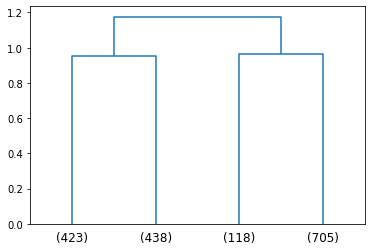

In [55]:
link = shc.linkage(reduced_word2vec_embedding,method='average',metric='cosine')

fig = shc.dendrogram(link,truncate_mode='lastp',p=4)
display(HTML("<p>word2vec_embedding<p>"))

#### Clustering S_biobert 

In [56]:
scores = find_best_k_using_avg_silloutte(reduced_S_biobert_embedding)

100%|██████████| 38/38 [00:20<00:00,  1.83it/s]


 Mean silhouette scores for different values of K

In [57]:
px.line(x = list(range(2,40)) , y = scores ,labels = {"y" : 'silhouette_score' ,"x" : 'K' }
       ).update_layout(title= "silhouette scores for S_biobert")

#### Dendrogram

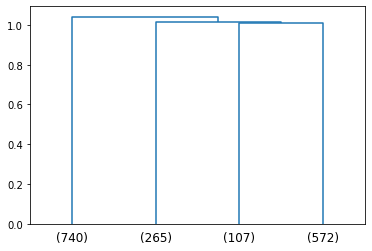

In [58]:
link = shc.linkage(reduced_S_biobert_embedding,method='average',metric='cosine')

fig = shc.dendrogram(link,truncate_mode='lastp',p=4)
display(HTML("<p>S_biobert_embedding<p>"))

#### Clustering Biobert-nli 

In [59]:
scores = find_best_k_using_avg_silloutte(reduced_biobert_embedding)

100%|██████████| 38/38 [00:13<00:00,  2.76it/s]


 Mean silhouette scores for different values of K

In [60]:
px.line(x = list(range(2,40)) , y = scores ,labels = {"y" : 'silhouette_score' ,"x" : 'K' }
       ).update_layout(title= "silhouette scores for biobert-nli")

#### Dendrogram

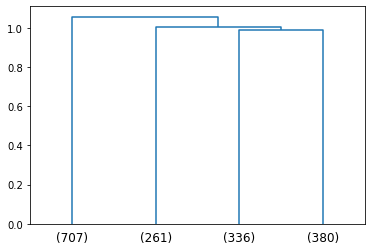

In [61]:
link = shc.linkage(reduced_biobert_embedding,method='average',metric='cosine')

fig = shc.dendrogram(link,truncate_mode='lastp',p=4)
display(HTML("<p>biobert-nli embedding<p>"))

#### Clustering covidbert-nli


In [62]:
scores = find_best_k_using_avg_silloutte(reduced_covidbert_embedding)

100%|██████████| 38/38 [00:10<00:00,  3.66it/s]


 Mean silhouette scores for different values of K

In [63]:
px.line(x = list(range(2,40)) , y = scores ,labels = {"y" : 'silhouette_score' ,"x" : 'K' }
       ).update_layout(title= "silhouette scores for covidbert-nli")

#### Dendrogram

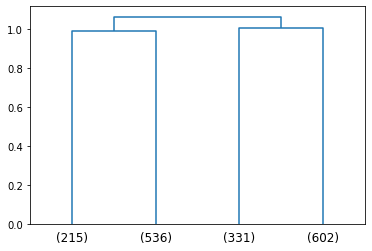

In [64]:
link = shc.linkage(reduced_covidbert_embedding,method='average',metric='cosine')

fig = shc.dendrogram(link,truncate_mode='lastp',p=4)
display(HTML("<p>covidbert-nli embedding<p>"))

# Visualization

After finding the optimum number of k from the silhouette plot and dendrograms. We obtain the flat clusters and visualize them with the help of scatter plot and word clouds. 

In [65]:

def get_tsne_projections(features: np.array, pca_n_component=20,
                         tsne_perplexity=30):
    # First, we perform PCA to reduce computation time for T-sne.
  
    pca = PCA(n_components=pca_n_component)
    components = pca.fit_transform(features)
    # Second, we use pca_components for TSNE
    tsne = TSNE(n_components=2, random_state=0, perplexity=tsne_perplexity)
    projections = tsne.fit_transform(components)
    projection_df = pd.DataFrame({
        'x': projections[:, 0],
        'y': projections[:, 1],

    })
    return projection_df

In [66]:
def cluster(X,k):
    """This performs agglomerative clustering with cosine affinity and average linkage"""
    agglomerative_model = AgglomerativeClustering(n_clusters=k,affinity='cosine',linkage='average')
    clustering = agglomerative_model.fit(X)
    score = silhouette_score(X, clustering.labels_)
    return clustering.labels_,score

In [67]:
def cluster_plot(df,embedding,cluster_label):
    """This function plots a scatter plot with cluster labels"""
    
    projection = get_tsne_projections(embedding)
    projection['cluster'] = cluster_label
    projection['title'] = df.title
    
    fig = px.scatter(projection,x='x',y='y',color=projection.cluster.astype(str),
    hover_data =['title'],color_discrete_sequence= px.colors.qualitative.Light24)
    return fig

In [68]:
def get_cluster_text(df,cluster,cluster_labels):

    merge = df[cluster_labels == cluster].abstract_token.apply(lambda x : " ".join(x)).tolist()
    merge = " ".join(merge)

    return merge

In [69]:
# !pip install wordcloud
from wordcloud import WordCloud

In [70]:
from plotly.subplots import make_subplots
def get_word_clouds(df,cluster_labels):
    """This function is used to plot the wordclouds for different clusters"""
    
    traces = []
    for cluster in set(cluster_labels):
        cluster_text =  get_cluster_text(df,cluster,cluster_labels)
        wordcloud= WordCloud().generate_from_text(cluster_text)
        wordcloud.background_color='white'
        traces.append(go.Image(z=wordcloud))

    fig = make_subplots(2, 2,
                       subplot_titles=("Cluster 1", "Cluster 2", "Cluster 3", "Cluster 4"))
    fig.add_traces(data=traces,rows=[1,1,2,2],cols=[1,2,1,2]
                  ).update_xaxes(showticklabels=False).update_yaxes(showticklabels=False)
    return fig

## Word2Vec with 4 cluster

In [71]:
word2vec_cluster_labels,word2vec_cluster_score=cluster(reduced_word2vec_embedding,4)

In [72]:
print("SCORE :",word2vec_cluster_score)

SCORE : 0.07115897007850312


In [73]:
cluster_plot(df,reduced_word2vec_embedding,word2vec_cluster_labels).update_layout(title="Word2vec")

In [74]:
get_word_clouds(df,word2vec_cluster_labels).update_layout(title="Word2vec")

## S_biobert with 4 cluster

In [75]:
S_biobert_cluster_labels,S_biobert_cluster_score=cluster(reduced_S_biobert_embedding,4)

In [76]:
print("SCORE :",S_biobert_cluster_score)

SCORE : 0.028674176


In [77]:
cluster_plot(df,reduced_S_biobert_embedding,S_biobert_cluster_labels).update_layout(title="S_biobert")

In [78]:
get_word_clouds(df,S_biobert_cluster_labels).update_layout(title="S_biobert")

## Biobert-nli with 4 cluster

In [79]:
biobert_cluster_labels,biobert_cluster_score=cluster(reduced_biobert_embedding,4)

In [80]:
print("SCORE :",biobert_cluster_score)

SCORE : 0.039508753


In [81]:
cluster_plot(df,reduced_biobert_embedding,biobert_cluster_labels).update_layout(title="Biobert-nli")

In [82]:
get_word_clouds(df,biobert_cluster_labels).update_layout(title="Biobert-nli")

## Covidbert-nli with 4 cluster

In [83]:
covidbert_cluster_labels,covidbert_cluster_score=cluster(reduced_covidbert_embedding,4)

In [84]:
print("SCORE :",covidbert_cluster_score)

SCORE : 0.041017473


In [85]:
cluster_plot(df,reduced_covidbert_embedding,covidbert_cluster_labels).update_layout(title="Covidbert-nli")

In [86]:
get_word_clouds(df,covidbert_cluster_labels).update_layout(title="Covidbert-nli")

# LDA 

We use the found clusters to to perform topic modelling using LDA

The following Parameters are used for the algorithm:
{'batch_size': 128,
 'doc_topic_prior': None,
 'evaluate_every': -1,
 'learning_decay': 0.7,
 'learning_method': 'batch',
 'learning_offset': 10.0,
 'max_doc_update_iter': 100,
 'max_iter': 10,
 'mean_change_tol': 0.001,
 'n_components': 2,
 'n_jobs': -1,
 'perp_tol': 0.1,
 'random_state': 2,
 'topic_word_prior': None,
 'total_samples': 1000000.0,
 'verbose': 0}

**Reference**
https://towardsdatascience.com/end-to-end-topic-modeling-in-python-latent-dirichlet-allocation-lda-35ce4ed6b3e0

In [87]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation as LDA

In [88]:
def get_topics_LDA(cluster_labels,number_topics = 4,number_words = 4):
    """This function is used to print the topics via LDA given the cluster labels, the default parameters are used"""
    #initilaizing the count vectorizer
    count = CountVectorizer(stop_words='english')
    for cluster in set(cluster_labels):

        cluster_text =  df[word2vec_cluster_labels ==cluster].abstract_token.apply(lambda x: " ".join(x))
        count_data= count.fit_transform(cluster_text)
        lda = LDA(n_components=number_topics, n_jobs=-1,random_state=2)
        lda.fit(count_data)
        print("*"*40)
        print("Topics found in cluster :{}".format(cluster))
        print("*"*40)
    #     print_topics(lda, count, number_words)
        words = count.get_feature_names()
        for topic_idx, topic in enumerate(lda.components_):
            print("\nTopic #%d:" % topic_idx)
            print(" ".join([words[i]
                            for i in topic.argsort()[:-number_words - 1:-1]]))


LDA can be used to model topics by passing the cluster labels,number of topics and number of words in topics

In [89]:
get_topics_LDA(word2vec_cluster_labels,number_topics = 2,number_words = 2)

****************************************
Topics found in cluster :0
****************************************

Topic #0:
cell protein

Topic #1:
virus cell
****************************************
Topics found in cluster :1
****************************************

Topic #0:
health disease

Topic #1:
health infection
****************************************
Topics found in cluster :2
****************************************

Topic #0:
vaccine virus

Topic #1:
virus vaccine
****************************************
Topics found in cluster :3
****************************************

Topic #0:
patient respiratory

Topic #1:
virus dog
